In [1]:
import json
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [2]:
with open("pose_data.json") as f:
    data = json.load(f)

In [3]:
num_frames = len(data)
num_keypoints = len(data[0]["keypoints"])
num_keypoints

17

In [4]:
x = np.zeros((num_keypoints, num_frames))
y = np.zeros((num_keypoints, num_frames))

In [5]:
for i, frame in enumerate(data):
    kps = np.array(frame["keypoints"])
    x[:, i] = kps[:, 1]
    y[:, i] = kps[:, 0]

In [6]:
x -= np.mean(x)
y -= np.mean(y)

Text(0.5, 0, 'Frame')

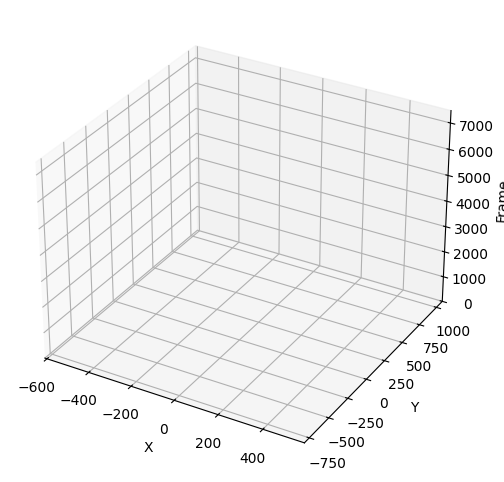

In [7]:
# gpt was used for 3-d visulization

# ---- Setup 3D plot ----
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(111, projection="3d")

ax.set_xlim(np.min(x), np.max(x))
ax.set_ylim(np.min(y), np.max(y))
ax.set_zlim(0, num_frames)
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Frame")

In [8]:
sc = ax.scatter(x[:, 0], y[:, 0], np.zeros(num_keypoints), c='b', s=50)

In [9]:
def update(frame):
    sc._offsets3d = (x[:, frame], y[:, frame], np.ones(num_keypoints)*frame)
    ax.set_title(f"Frame {frame+1}/{num_frames}")
    return sc,

In [10]:
ani = FuncAnimation(fig, update, frames=num_frames, interval=50, blit=False)

In [11]:
HTML(ani.to_jshtml())

Animation size has reached 20985134 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
